In [ ]:
 # First, remove any existing installations and directories
!pip uninstall -y panelview
!rm -rf panelview

# Now clone with a different directory name to avoid conflicts
!rm -rf panelview_rp
from google.colab import userdata
github_token = userdata.get('GitHub')
!git clone https://{github_token}@github.com/akimovhhh/panelview.git panelview_rp

# Install from the cloned repository
%cd panelview_rp
!pip install -e .

# Return to the original directory
%cd ..

Found existing installation: panelview 0.1.47
Uninstalling panelview-0.1.47:
ERROR: Operation cancelled by user
Cloning into 'panelview_rp'...
remote: Enumerating objects: 293, done.
remote: Total 293 (delta 0), reused 0 (delta 0), pack-reused 293 (from 1)
Receiving objects: 100% (293/293), 43.16 KiB | 1.96 MiB/s, done.
Resolving deltas: 100% (184/184), done.
/content/panelview_rp
Obtaining file:///content/panelview_rp
  Preparing metadata (setup.py) ... done
  Running setup.py develop for panelview
/content


In [ ]:
import warnings
warnings.filterwarnings("ignore")

# Imorting libraries
import pandas as pd
import numpy as np
# import chart_studio.plotly as py
import seaborn as sns
import plotly.express as px
import math
import cufflinks as cf
import plotly.figure_factory as ff
import scipy
import plotly.graph_objects as go
from statsmodels.regression.linear_model import OLS
from statsmodels.tools.tools import add_constant
from datetime import timedelta
from subprocess import check_output
import matplotlib as plt
from pathlib import Path
from plotly.subplots import make_subplots
import concurrent.futures
import tqdm
import multiprocessing
from google.colab import drive
import os
drive.mount('/content/drive')
from itertools import starmap
import pickle
import panelview as pv
import plotly.graph_objects as go
import plotly.io as pio
import math


# Set the default renderer to "colab"
pio.renderers.default = "colab"


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

cf.go_offline()

Mounted at /content/drive


In [ ]:
 # Import city_code-city_name dictionary from BTS webcite
city_dict = pd.read_csv("/content/drive/My Drive//predatory pricing/data/dict/L_CITY_MARKET_ID.csv")
city_met = pd.read_excel('/content/drive/My Drive//predatory pricing/data/dict/city_met.xlsx')
base_path = Path("/content/drive/My Drive//predatory pricing/data")
max_workers = 3

\# Step 1: Determining what markets to drop

In [ ]:
def read_t100(year):
    file_path = base_path / f"T100/{year}.csv"
    try:
        t100_columns = ['DEPARTURES_PERFORMED', 'SEATS', 'PASSENGERS', 'ORIGIN_CITY_MARKET_ID', 'DEST_CITY_MARKET_ID', 'UNIQUE_CARRIER', 'CLASS', 'YEAR', 'QUARTER', 'MONTH']
        result = pd.read_csv(file_path, usecols = t100_columns)
        result = result.query("DEPARTURES_PERFORMED >0 and CLASS in ['F']")
        return result  # Add this return statement
    except FileNotFoundError:
        print(f"File not found: {file_path}")
        return None

years = [year for year in range(2005, 2025)]

t100_list = []
with concurrent.futures.ThreadPoolExecutor(max_workers=max_workers) as executor:
    futures = {executor.submit(read_t100, year): year for year in years}

    for future in tqdm.tqdm(concurrent.futures.as_completed(futures), total=len(futures)):
        year = futures[future]
        try:
            data = future.result()
            if data is not None:
                t100_list.append(data)
        except Exception as e:
            print(f"Error processing year {year}: {e}")

# Combine all results (only if there's data to combine)
if t100_list:
    t100 = pd.concat(t100_list, ignore_index=True)
else:
    print("No data was successfully loaded")

100%|██████████| 20/20 [00:51<00:00,  2.57s/it]


In [ ]:
# Adding msa data, measuring how many data we've lost
pass_before = t100['PASSENGERS'].sum()
t100 = pd.merge(t100, city_met,  left_on = 'ORIGIN_CITY_MARKET_ID', right_on = 'code')
t100 = pd.merge(t100, city_met,  left_on = 'DEST_CITY_MARKET_ID', right_on = 'code')
pass_after = t100['PASSENGERS'].sum()
pass_dropped = pass_before - pass_after
drop_percentage = (pass_dropped / pass_before) * 100
print(f"Dropping records, without matching MSA data {pass_dropped} passangers dropped ({drop_percentage:.2f}%)")
t100 = t100.dropna()
pass_after2 = t100['PASSENGERS'].sum()
pass_dropped = pass_after - pass_after2
drop_percentage = (pass_dropped / pass_after) * 100
print(f"Dropping records, with missing data {pass_dropped} passangers dropped ({drop_percentage:.2f}%)")


Dropping records, without matching MSA data 193152764.0 passangers dropped (1.41%)
Dropping records, with missing data 1193339.0 passangers dropped (0.01%)


In [ ]:
all_city_pairs = t100[['MSA_x', 'MSA_y']].drop_duplicates()
city_pairs = all_city_pairs.apply(tuple, axis=1).tolist()


# Step 2: Create a mapping dictionary
mapping_dict = {pair: idx for idx, pair in enumerate(city_pairs)}

# Step 4: Save the mapping for future use
with open('/content/drive/My Drive//predatory pricing/data/dict/city_pair_mapping.pkl', 'wb') as f:
    pickle.dump(mapping_dict, f)

pairs = list(zip(t100['MSA_x'], t100['MSA_y']))
t100['market_id'] = [mapping_dict.get(p) for p in pairs]

In [ ]:
target_routes = ['.Hilo-Kailua, HI Micro Area', '.Kahului-Wailuku, HI Metro Area',
                 '.Kapaa, HI Micro Area', '.Urban Honolulu, HI Metro Area']

In [ ]:
hi_markets = t100.query('MSA_x in @target_routes or MSA_y in @target_routes and MSA_x!=MSA_y').market_id.unique()
ihi_markets = t100.query('MSA_x in @target_routes and MSA_y in @target_routes and MSA_x!=MSA_y').market_id.unique()

In [ ]:
t100_quarter = t100.groupby(by=['UNIQUE_CARRIER', 'YEAR', 'QUARTER', 'market_id'], as_index=False)[['DEPARTURES_PERFORMED', 'SEATS', 'PASSENGERS']].sum()

In [ ]:
t100_agg = t100_quarter.groupby(by=['YEAR', 'QUARTER', 'market_id'], as_index=False)[['DEPARTURES_PERFORMED', 'SEATS', 'PASSENGERS']].sum()
t100_agg_agg =  t100_agg.groupby(by=['market_id'], as_index=False)[['DEPARTURES_PERFORMED', 'SEATS', 'PASSENGERS']].mean()

(0.0, 2000.0)

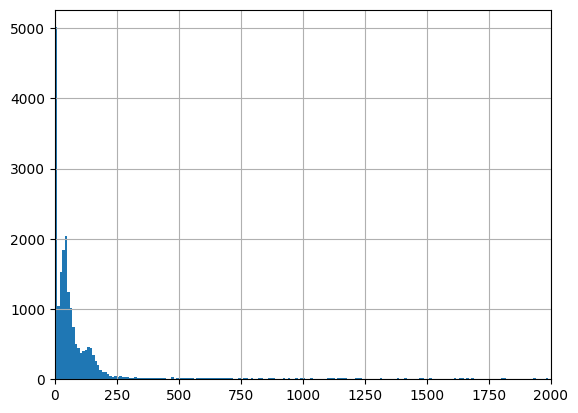

In [ ]:
fig = t100_agg_agg.query('PASSENGERS<10000').PASSENGERS.hist(bins = 1000)
fig.set_xlim(0, 2000)


(0.0, 100.0)

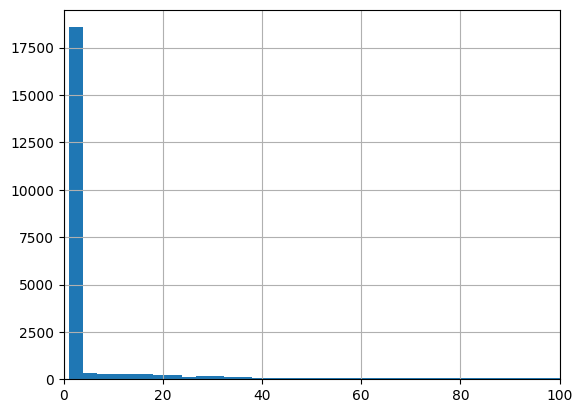

In [ ]:
fig = t100_agg_agg.DEPARTURES_PERFORMED.hist(bins = 5000)
fig.set_xlim(0, 100)


There is not that much difference between dropping markets with less than 500 or 1000 passengers, so I drop less than 1000, cause it seems right.

In [ ]:
# Drop segments with less than 500 passangers per quarter on average
mkts = t100_agg_agg.query('PASSENGERS > 500 and DEPARTURES_PERFORMED>=12').market_id.unique()
t100 = t100.query("market_id in @mkts")
t100_quarter = t100_quarter.query("market_id in @mkts")
t100_agg = t100_agg.query("market_id in @mkts")

# Step 2: For markets that stayed, I want do determine quarters that they properly existed.

It might be that the average number of passengers is greater than 1000, but some quarters will have like 10 passengers. I want to drop those quarters.

(0.0, 2000.0)

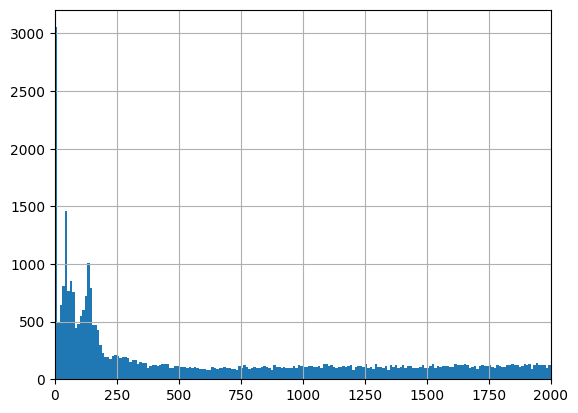

In [ ]:
fig = t100_agg.query('PASSENGERS<10000').PASSENGERS.hist(bins = 1000)
fig.set_xlim(0, 2000)

In [ ]:
tmp = t100_agg.query('PASSENGERS > 250 and DEPARTURES_PERFORMED>=6')[['market_id', 'YEAR', 'QUARTER']].drop_duplicates()
t100 = pd.merge(t100, tmp, on = ['market_id', 'YEAR', 'QUARTER'], how = 'inner')
t100_quarter = pd.merge(t100_quarter, tmp, on = ['market_id', 'YEAR', 'QUARTER'], how = 'inner')


# Step 3: filter the Carriers

In [ ]:
t100_quarter['market_size'] = t100_quarter.groupby(by=['YEAR', 'QUARTER', 'market_id']).PASSENGERS.transform('sum')
t100_quarter['market_share'] = t100_quarter.PASSENGERS/t100_quarter.market_size *100

(0.0, 2000.0)

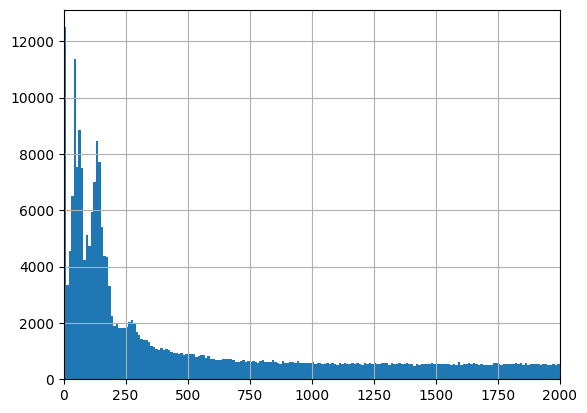

In [ ]:
fig = t100_quarter.query('PASSENGERS<10000').PASSENGERS.hist(bins = 1000)
fig.set_xlim(0, 2000)

In [ ]:
t100_quarter = t100_quarter.query('market_share>1 and PASSENGERS > 250 and DEPARTURES_PERFORMED >= 6')

In [ ]:
tmp = t100_quarter[['market_id', 'YEAR', 'QUARTER', 'UNIQUE_CARRIER']].drop_duplicates()
t100 = pd.merge(t100, tmp, on = ['market_id', 'YEAR', 'QUARTER', 'UNIQUE_CARRIER'], how = 'inner')

In [ ]:
t100['date'] = pd.to_datetime(
            t100['YEAR'].astype(str) + '-' +
            (t100['MONTH']).astype(str) + '-01'
        )
t100_quarter['date'] = pd.to_datetime(
            t100_quarter['YEAR'].astype(str) + '-' +
            ((t100_quarter['QUARTER'] - 1) * 3 + 1).astype(str) + '-01'
        )

In [ ]:
t100.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence_OpCarrier_monthly.csv')
t100_quarter.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence_OpCarrier_quarterly.csv')

In [ ]:
del(t100_agg)
del(t100_agg_agg)

#Step 4: Forming the final list of markets.

T100 data is for operating carriers, we need to match it to OpCarriers in DB1B, then find a list of markets which SW entered as TkCarrier since 2010


In [ ]:
# Example: set your desired number of threads
max_workers = 4

# Make a small helper DataFrame with valid (date, city_pair, UNIQUE_CARRIER) combos from T100
valid_t100_keys = t100_quarter[['date','market_id','UNIQUE_CARRIER']].drop_duplicates()

# Define base path (update if needed)
base_path = Path("/content/drive/My Drive/predatory pricing/data/DB1B")

def process_quarter(year_quarter):
    """Reads one quarter of DB1B Market data with pandas, merges city MSA info,
       constructs city_pair, and returns the filtered DataFrame."""
    year, q = year_quarter

    # Example: skip 2024 Q4 if it doesn't exist
    if year == 2024 and q == 4:
        return None

    market_file = base_path / f"Market/Origin_and_Destination_Survey_DB1BMarket_{year}_{q}.csv"

    # Only the columns you need
    market_cols = [
        'TkCarrier', 'MktCoupons',
        'OriginCityMarketID', 'DestCityMarketID',
        'Year', 'Quarter', 'OpCarrier', 'Passengers'
    ]

    try:
        # --- Always use pandas ---
        market = pd.read_csv(market_file, usecols=market_cols)

        # Keep only single-coupon tickets (i.e., direct flights)
        market = market.query('MktCoupons == 1').drop_duplicates()
        market = market.groupby([
        'TkCarrier', 'MktCoupons',
        'OriginCityMarketID', 'DestCityMarketID',
        'Year', 'Quarter', 'OpCarrier'], as_index = False).Passengers.sum()

        # Create a date column for easy merging with T100
        # Using the first month of the quarter
        market['date'] = pd.to_datetime(
            market['Year'].astype(str) + '-' +
            ((market['Quarter'] - 1) * 3 + 1).astype(str) + '-01'
        )

        # Merge origin MSA
        market = pd.merge(
            market,
            city_met,  # city_met must have columns ['code', 'MSA']
            left_on='OriginCityMarketID',
            right_on='code',
            how='left'
        )

        # Merge destination MSA
        market = pd.merge(
            market,
            city_met,
            left_on='DestCityMarketID',
            right_on='code',
            how='left',
            suffixes=('_orig','_dest')
        )

        pairs = list(zip(market['MSA_orig'], market['MSA_dest']))
        market['market_id'] = [mapping_dict.get(p) for p in pairs]
        market = market.merge(
            valid_t100_keys,
            left_on=['date', 'market_id', 'OpCarrier'],
            right_on=['date', 'market_id', 'UNIQUE_CARRIER'],
            how='inner'
        )
        market = market.drop(columns=['UNIQUE_CARRIER']).drop_duplicates()

        return market

    except Exception as e:
        print(f"Error processing {year} Q{q}: {e}")
        return None

# Create year-quarter pairs (adjust years/quarters as needed)
year_quarter_pairs = [
    (year, q)
    for year in range(2005, 2025)
    for q in range(1, 5)
    if not (year == 2024 and q == 4)
]

# Read each quarter in parallel
results = []
with concurrent.futures.ThreadPoolExecutor(max_workers=max_workers) as executor:
    futures = {executor.submit(process_quarter, yq): yq for yq in year_quarter_pairs}

    for future in tqdm.tqdm(concurrent.futures.as_completed(futures), total=len(futures)):
        yq = futures[future]
        try:
            data = future.result()
            if data is not None:
                results.append(data)
                print(f"Completed {yq[0]} Q{yq[1]}")
        except Exception as e:
            print(f"Error processing {yq[0]} Q{yq[1]}: {e}")

# Combine all quarters
db1b = pd.concat(results, ignore_index=True)
print(f"DB1B shape after concatenation: {db1b.shape}")


  1%|▏         | 1/79 [01:35<2:04:15, 95.58s/it]

Completed 2005 Q1


  3%|▎         | 2/79 [01:40<53:52, 41.98s/it]  

Completed 2005 Q4


  4%|▍         | 3/79 [01:43<30:52, 24.38s/it]

Completed 2005 Q3


  5%|▌         | 4/79 [01:50<21:44, 17.39s/it]

Completed 2005 Q2


  6%|▋         | 5/79 [03:17<52:46, 42.79s/it]

Completed 2006 Q1


  8%|▊         | 6/79 [03:22<36:24, 29.92s/it]

Completed 2006 Q3


  9%|▉         | 7/79 [03:30<27:11, 22.65s/it]

Completed 2006 Q2


 10%|█         | 8/79 [03:32<19:07, 16.17s/it]

Completed 2006 Q4


 11%|█▏        | 9/79 [05:00<44:45, 38.36s/it]

Completed 2007 Q1


 13%|█▎        | 10/79 [05:10<34:05, 29.64s/it]

Completed 2007 Q2


 14%|█▍        | 11/79 [05:19<26:22, 23.28s/it]

Completed 2007 Q3


 15%|█▌        | 12/79 [05:21<18:57, 16.97s/it]

Completed 2007 Q4


 16%|█▋        | 13/79 [06:48<41:49, 38.03s/it]

Completed 2008 Q1


 18%|█▊        | 14/79 [07:04<34:09, 31.54s/it]

Completed 2008 Q4


 19%|█▉        | 15/79 [07:04<23:38, 22.16s/it]

Completed 2008 Q3


 20%|██        | 16/79 [07:14<19:14, 18.32s/it]

Completed 2008 Q2


 22%|██▏       | 17/79 [08:10<30:35, 29.61s/it]

Completed 2009 Q1


 23%|██▎       | 18/79 [08:39<29:59, 29.50s/it]

Completed 2009 Q2


 24%|██▍       | 19/79 [08:45<22:21, 22.36s/it]

Completed 2009 Q3


 25%|██▌       | 20/79 [08:54<18:10, 18.48s/it]

Completed 2009 Q4


 27%|██▋       | 21/79 [09:48<28:11, 29.17s/it]

Completed 2010 Q1


 28%|██▊       | 22/79 [10:33<32:03, 33.74s/it]

Completed 2010 Q2


 29%|██▉       | 23/79 [10:35<22:46, 24.41s/it]

Completed 2010 Q3


 30%|███       | 24/79 [10:51<19:53, 21.71s/it]

Completed 2010 Q4


 32%|███▏      | 25/79 [11:31<24:37, 27.36s/it]

Completed 2011 Q1


 33%|███▎      | 26/79 [12:31<32:41, 37.01s/it]

Completed 2011 Q2


 34%|███▍      | 27/79 [12:34<23:21, 26.96s/it]

Completed 2011 Q3


 35%|███▌      | 28/79 [12:40<17:23, 20.45s/it]

Completed 2011 Q4


 37%|███▋      | 29/79 [13:32<24:55, 29.90s/it]

Completed 2012 Q1


 38%|███▊      | 30/79 [14:43<34:30, 42.25s/it]

Completed 2012 Q2


 39%|███▉      | 31/79 [14:43<23:47, 29.75s/it]

Completed 2012 Q3


 41%|████      | 32/79 [14:44<16:31, 21.10s/it]

Completed 2012 Q4


 42%|████▏     | 33/79 [15:41<24:18, 31.70s/it]

Completed 2013 Q1


 43%|████▎     | 34/79 [17:05<35:39, 47.55s/it]

Completed 2013 Q3


 44%|████▍     | 35/79 [17:07<24:53, 33.95s/it]

Completed 2013 Q4


 46%|████▌     | 36/79 [17:08<17:13, 24.04s/it]

Completed 2013 Q2


 47%|████▋     | 37/79 [17:41<18:34, 26.54s/it]

Completed 2014 Q1


 48%|████▊     | 38/79 [19:23<33:38, 49.23s/it]

Completed 2014 Q2


 49%|████▉     | 39/79 [19:25<23:30, 35.27s/it]

Completed 2014 Q4


 51%|█████     | 40/79 [19:26<16:10, 24.87s/it]

Completed 2014 Q3


 52%|█████▏    | 41/79 [19:39<13:31, 21.36s/it]

Completed 2015 Q1


 54%|█████▍    | 43/79 [21:32<20:31, 34.22s/it]

Completed 2015 Q2
Completed 2016 Q1


 56%|█████▌    | 44/79 [21:33<14:05, 24.15s/it]

Completed 2015 Q4


 57%|█████▋    | 45/79 [21:34<09:41, 17.12s/it]

Completed 2015 Q3


 58%|█████▊    | 46/79 [23:41<27:33, 50.12s/it]

Completed 2017 Q1


 59%|█████▉    | 47/79 [23:50<20:16, 38.02s/it]

Completed 2016 Q3


 61%|██████    | 48/79 [23:51<13:51, 26.81s/it]

Completed 2016 Q4


 62%|██████▏   | 49/79 [23:51<09:26, 18.87s/it]

Completed 2016 Q2


 65%|██████▍   | 51/79 [25:57<16:39, 35.69s/it]

Completed 2017 Q2
Completed 2018 Q1


 66%|██████▌   | 52/79 [25:59<11:27, 25.47s/it]

Completed 2017 Q3


 67%|██████▋   | 53/79 [26:16<09:54, 22.85s/it]

Completed 2017 Q4


 68%|██████▊   | 54/79 [28:27<23:06, 55.45s/it]

Completed 2018 Q3


 70%|██████▉   | 55/79 [28:32<16:07, 40.30s/it]

Completed 2018 Q2


 71%|███████   | 56/79 [28:32<10:50, 28.27s/it]

Completed 2019 Q1


 72%|███████▏  | 57/79 [28:39<07:56, 21.66s/it]

Completed 2018 Q4


 73%|███████▎  | 58/79 [30:33<17:16, 49.34s/it]

Completed 2020 Q1


 75%|███████▍  | 59/79 [30:49<13:08, 39.40s/it]

Completed 2020 Q2


 76%|███████▌  | 60/79 [30:57<09:31, 30.06s/it]

Completed 2019 Q3


 77%|███████▋  | 61/79 [31:03<06:49, 22.76s/it]

Completed 2019 Q2


 78%|███████▊  | 62/79 [31:03<04:32, 16.04s/it]

Completed 2019 Q4


 80%|███████▉  | 63/79 [31:53<07:00, 26.27s/it]

Completed 2020 Q3


 81%|████████  | 64/79 [32:16<06:16, 25.10s/it]

Completed 2020 Q4


 82%|████████▏ | 65/79 [32:22<04:33, 19.53s/it]

Completed 2021 Q1


 84%|████████▎ | 66/79 [33:13<06:16, 28.99s/it]

Completed 2021 Q2


 85%|████████▍ | 67/79 [34:13<07:39, 38.31s/it]

Completed 2021 Q3


 86%|████████▌ | 68/79 [34:29<05:45, 31.44s/it]

Completed 2022 Q1


 87%|████████▋ | 69/79 [34:36<04:00, 24.06s/it]

Completed 2021 Q4


 89%|████████▊ | 70/79 [35:43<05:32, 36.95s/it]

Completed 2022 Q2


 90%|████████▉ | 71/79 [36:43<05:50, 43.86s/it]

Completed 2022 Q3


 91%|█████████ | 72/79 [37:00<04:11, 35.89s/it]

Completed 2023 Q1


 92%|█████████▏| 73/79 [37:00<02:31, 25.30s/it]

Completed 2022 Q4


 94%|█████████▎| 74/79 [38:23<03:32, 42.46s/it]

Completed 2023 Q2


 95%|█████████▍| 75/79 [39:28<03:17, 49.31s/it]

Completed 2023 Q3


 96%|█████████▌| 76/79 [39:46<02:00, 40.01s/it]

Completed 2024 Q1


 97%|█████████▋| 77/79 [39:50<00:58, 29.13s/it]

Completed 2023 Q4


 99%|█████████▊| 78/79 [40:37<00:34, 34.41s/it]

Completed 2024 Q2


100%|██████████| 79/79 [40:50<00:00, 31.02s/it]

Completed 2024 Q3
DB1B shape after concatenation: (776160, 16)


In [ ]:
db1b['market_size'] = db1b.groupby(by=['Year', 'Quarter', 'market_id']).Passengers.transform('sum')
db1b['market_share'] = db1b.Passengers/db1b.market_size *100

In [ ]:
db1b = db1b.query('market_share>1 and Passengers>25')

In [ ]:
route_presence = db1b[['date', 'TkCarrier', 'market_id']].drop_duplicates()

In [ ]:
route_presence.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence.csv')

In [ ]:
route_presence = pd.read_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence.csv', index_col = 0)

In [ ]:
route_presence['sw_market'] = (route_presence.TkCarrier == 'WN').astype(int)

In [ ]:
route_presence.sw_market = route_presence.groupby('market_id').sw_market.transform('max')

In [ ]:
route_presence = route_presence.sort_values(by = 'date')
entry = route_presence.groupby(by = ['market_id', 'TkCarrier'], as_index = False )['date'].first()
entry = entry.query("date >= '2011-01-01'")
entry.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/any_entry.csv')

In [ ]:
sw_entry = entry.query("TkCarrier == 'WN'")
sw_entry.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/sw_entry.csv')

In [ ]:
route_list = route_presence.query('market_id in @sw_entry.market_id or sw_market == 0').market_id.drop_duplicates()
route_list.to_csv('/content/drive/My Drive/predatory pricing/data/dict/route_list.csv')

In [ ]:
route_list = pd.read_csv('/content/drive/My Drive/predatory pricing/data/dict/route_list.csv', index_col = 0)

In [ ]:
route_presence_filt =route_presence.query("market_id in @route_list.market_id")

In [ ]:
route_presence_filt.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence_filt.csv')

In [ ]:
route_presence_filt = pd.read_csv('/content/drive/My Drive/predatory pricing/data/temporal/route_presence_filt.csv', index_col = 0)

In [ ]:
route_presence_filt.date = pd.to_datetime(route_presence_filt.date)

In [ ]:
with open('/content/drive/My Drive//predatory pricing/data/dict/city_pair_mapping.pkl', 'rb') as f:
    mapping_dict = pickle.load(f)

# Step 5: create final sample, filtering for prices

In [ ]:
max_workers = 4
base_path = Path("/content/drive/My Drive/predatory pricing/data/DB1B")


def process_quarter(year_quarter):
    year, q = year_quarter
    if year == 2024 and q == 4:
        return None

    try:
        # Define file paths
        market_file = base_path / f"Market/Origin_and_Destination_Survey_DB1BMarket_{year}_{q}.csv"
        market_cols = ['TkCarrier', 'MktCoupons', 'OriginCityMarketID', 'DestCityMarketID',
                       'Year', 'Quarter', 'MktFare', 'Passengers', 'OriginState', 'DestState']

        market = pd.read_csv(market_file, usecols=market_cols)
        market = market.query('MktCoupons == 1')

        market['date'] = pd.to_datetime(
            market['Year'].astype(str) + '-' +
            ((market['Quarter'] - 1) * 3 + 1).astype(str) + '-01'
        )

        # Merge origin MSA
        market = pd.merge(
            market,
            city_met,  # city_met must have columns ['code', 'MSA']
            left_on='OriginCityMarketID',
            right_on='code',
            how='left'
        )

        # Merge destination MSA
        market = pd.merge(
            market,
            city_met,
            left_on='DestCityMarketID',
            right_on='code',
            how='left',
            suffixes=('_orig','_dest')
        )

        pairs = list(zip(market['MSA_orig'], market['MSA_dest']))
        market['market_id'] = [mapping_dict.get(p) for p in pairs]
        market = market.merge(
            route_presence_filt,
            on=['date', 'market_id', 'TkCarrier'],
            how='inner'
        )

        # market = market.drop_duplicates()

        market = market[market['MktFare'] > 10]
        market = market.sort_values(by='MktFare')

        market['passengers_per_quarter'] = market.groupby(by=['TkCarrier', 'market_id']).Passengers.transform('sum')
        market['passengers_per_quarter_cum'] = market.groupby(by=['TkCarrier', 'market_id']).Passengers.transform('cumsum')

        mask = (
            (market['passengers_per_quarter_cum'] / market['passengers_per_quarter'] > 0.01) &
            (market['passengers_per_quarter_cum'] / market['passengers_per_quarter'] < 0.99)
        )
        market = market[mask]

        market['log_fares'] = np.log(market.MktFare)
        market['sum_fares'] = market.Passengers * market.MktFare
        market['sum_log_fares'] = market.Passengers * market.log_fares

        hw_data = market.query('market_id in [19, 691, 1184, 2090, 4849, 4850, 5627, 5681, 5711, 5740, 5917, 5918]')

        result = market.groupby(by=['date', 'market_id', 'TkCarrier',  'OriginState', 'DestState'], as_index=False)[['Passengers', 'sum_fares', 'sum_log_fares']].sum()

        print(f"Completed {year} Q{q}")
        return result, hw_data

    except Exception as e:
        print(f"Error processing {year} Q{q}: {e}")
        return None, None

# Create year-quarter pairs
year_quarter_pairs = [(year, q) for year in range(2010, 2025) for q in range(1, 5)
                     if not (year == 2024 and q == 4)]

# Process in parallel
market_list = []
hw_list = []
with concurrent.futures.ThreadPoolExecutor(max_workers=max_workers) as executor:
    futures = {executor.submit(process_quarter, yq): yq for yq in year_quarter_pairs}

    for future in tqdm.tqdm(concurrent.futures.as_completed(futures), total=len(futures)):
        yq = futures[future]
        try:
            result, hw_data = future.result()
            if result is not None:
                market_list.append(result)
                hw_list.append(hw_data)
                del(result)
                del(hw_data)
        except Exception as e:
            print(f"Error processing {yq[0]} Q{yq[1]}: {e}")

# Combine all results
market = pd.concat(market_list, ignore_index=True)
hw_df = pd.concat(hw_list, ignore_index=True)

# Save results
output_path = '/content/drive/My Drive/predatory pricing/data/temporal/rf_sample_2.csv'
market.to_csv(output_path)
output_path = '/content/drive/My Drive/predatory pricing/data/temporal/hw_tickets.csv'
hw_df.to_csv(output_path)
print(f"Saved results to {output_path}")

  0%|          | 0/59 [00:00<?, ?it/s]

Completed 2013 Q1
Completed 2013 Q3
Completed 2013 Q4
Completed 2013 Q2
Completed 2014 Q1


  2%|▏         | 1/59 [04:59<4:49:44, 299.74s/it]

Completed 2010 Q1
Completed 2010 Q3


  5%|▌         | 3/59 [05:47<1:17:58, 83.54s/it] 

Completed 2010 Q2
Completed 2010 Q4


  7%|▋         | 4/59 [05:48<46:50, 51.10s/it]  

Completed 2014 Q2
Completed 2014 Q4
Completed 2014 Q3
Completed 2015 Q1


  8%|▊         | 5/59 [10:37<2:03:00, 136.67s/it]

Completed 2011 Q1


 10%|█         | 6/59 [11:46<1:40:32, 113.82s/it]

Completed 2011 Q4


 12%|█▏        | 7/59 [11:58<1:09:51, 80.60s/it] 

Completed 2011 Q3
Completed 2011 Q2


 14%|█▎        | 8/59 [12:00<47:11, 55.52s/it]  

Completed 2015 Q3
Completed 2015 Q2
Completed 2015 Q4
Completed 2012 Q1


 15%|█▌        | 9/59 [16:06<1:35:53, 115.07s/it]

Completed 2016 Q1


 17%|█▋        | 10/59 [17:59<1:33:27, 114.44s/it]

Completed 2012 Q3


 19%|█▊        | 11/59 [18:00<1:03:44, 79.67s/it] 

Completed 2012 Q2


 20%|██        | 12/59 [18:01<43:36, 55.68s/it]  

Completed 2012 Q4
Completed 2016 Q2
Completed 2016 Q3
Completed 2016 Q4


 22%|██▏       | 13/59 [21:47<1:22:24, 107.49s/it]

Completed 2013 Q1
Completed 2017 Q1


 24%|██▎       | 14/59 [24:05<1:27:24, 116.55s/it]

Completed 2013 Q4


 25%|██▌       | 15/59 [24:06<59:52, 81.64s/it]   

Completed 2013 Q3
Completed 2013 Q2


 27%|██▋       | 16/59 [24:10<41:52, 58.43s/it]

Completed 2017 Q3
Completed 2017 Q2
Completed 2014 Q1


 29%|██▉       | 17/59 [27:46<1:14:02, 105.76s/it]

Completed 2017 Q4
Completed 2018 Q1


 32%|███▏      | 19/59 [31:37<1:06:50, 100.27s/it]

Completed 2014 Q2
Completed 2014 Q4


 34%|███▍      | 20/59 [31:39<46:07, 70.97s/it]   

Completed 2014 Q3


 36%|███▌      | 21/59 [34:30<1:03:48, 100.74s/it]

Completed 2015 Q1
Completed 2019 Q1
Completed 2018 Q3
Completed 2018 Q2
Completed 2018 Q4


 37%|███▋      | 22/59 [38:56<1:32:48, 150.51s/it]

Completed 2015 Q4


 39%|███▉      | 23/59 [38:58<1:03:31, 105.88s/it]

Completed 2015 Q2


 41%|████      | 24/59 [38:59<43:20, 74.30s/it]   

Completed 2015 Q3
Completed 2020 Q1


 42%|████▏     | 25/59 [41:33<55:38, 98.20s/it]

Completed 2016 Q1
Completed 2019 Q3
Completed 2020 Q2
Completed 2019 Q2
Completed 2019 Q4
Completed 2020 Q3
Completed 2020 Q4
Completed 2021 Q1


 44%|████▍     | 26/59 [46:33<1:27:24, 158.93s/it]

Completed 2016 Q3


 46%|████▌     | 27/59 [46:39<1:00:16, 113.00s/it]

Completed 2016 Q2


 47%|████▋     | 28/59 [46:40<40:57, 79.27s/it]   

Completed 2016 Q4


 49%|████▉     | 29/59 [48:19<42:36, 85.22s/it]

Completed 2017 Q1
Completed 2021 Q2
Completed 2021 Q3
Completed 2022 Q1
Completed 2021 Q4


 51%|█████     | 30/59 [53:39<1:15:21, 155.90s/it]

Completed 2017 Q3


 53%|█████▎    | 31/59 [53:46<51:46, 110.96s/it]  

Completed 2017 Q2


 54%|█████▍    | 32/59 [54:10<38:13, 84.96s/it] 

Completed 2017 Q4


 56%|█████▌    | 33/59 [55:31<36:23, 83.97s/it]

Completed 2018 Q1
Completed 2022 Q2
Completed 2022 Q3
Completed 2023 Q1
Completed 2022 Q4


 58%|█████▊    | 34/59 [1:01:32<1:09:32, 166.91s/it]

Completed 2018 Q3
Completed 2018 Q2


 61%|██████    | 36/59 [1:01:50<32:58, 86.03s/it] 

Completed 2018 Q4


 63%|██████▎   | 37/59 [1:03:01<29:53, 81.50s/it]

Completed 2019 Q1
Completed 2023 Q2
Completed 2023 Q3


 64%|██████▍   | 38/59 [1:09:16<59:22, 169.66s/it]

Completed 2020 Q1
Completed 2024 Q1
Completed 2023 Q4
Completed 2019 Q3


 66%|██████▌   | 39/59 [1:10:12<45:09, 135.48s/it]

Completed 2019 Q2


 68%|██████▊   | 40/59 [1:10:26<31:23, 99.13s/it] 

Completed 2019 Q4


 71%|███████   | 42/59 [1:11:06<16:57, 59.88s/it]

Completed 2020 Q2


 73%|███████▎  | 43/59 [1:12:57<20:00, 75.06s/it]

Completed 2020 Q3


 75%|███████▍  | 44/59 [1:13:20<14:54, 59.64s/it]

Completed 2020 Q4


 76%|███████▋  | 45/59 [1:13:28<10:15, 43.97s/it]

Completed 2021 Q1
Completed 2024 Q2


 78%|███████▊  | 46/59 [1:15:39<15:12, 70.16s/it]

Completed 2021 Q2
Completed 2024 Q3


 80%|███████▉  | 47/59 [1:17:44<17:20, 86.73s/it]

Completed 2021 Q3


 81%|████████▏ | 48/59 [1:17:47<11:15, 61.42s/it]

Completed 2022 Q1


 83%|████████▎ | 49/59 [1:17:59<07:47, 46.74s/it]

Completed 2021 Q4


 85%|████████▍ | 50/59 [1:20:16<11:02, 73.62s/it]

Completed 2022 Q2


 86%|████████▋ | 51/59 [1:22:06<11:17, 84.67s/it]

Completed 2023 Q1


 88%|████████▊ | 52/59 [1:22:07<06:56, 59.48s/it]

Completed 2022 Q3


 90%|████████▉ | 53/59 [1:22:09<04:14, 42.38s/it]

Completed 2022 Q4


 92%|█████████▏| 54/59 [1:25:00<06:44, 80.88s/it]

Completed 2023 Q2


 93%|█████████▎| 55/59 [1:27:16<06:30, 97.55s/it]

Completed 2024 Q1
Completed 2023 Q3


 97%|█████████▋| 57/59 [1:27:21<01:38, 49.13s/it]

Completed 2023 Q4


 98%|█████████▊| 58/59 [1:28:37<00:57, 57.25s/it]

Completed 2024 Q2


100%|██████████| 59/59 [1:29:04<00:00, 90.59s/it]

Completed 2024 Q3


Saved results to /content/drive/My Drive/predatory pricing/data/temporal/hw_tickets.csv


# Step 6: Final cleaning, constructing the panel

In [ ]:
df = pd.read_csv('/content/drive/My Drive/predatory pricing/data/temporal/rf_sample_2.csv', index_col = 0)

In [ ]:
sw_entry_date = df[df['TkCarrier'] == 'WN'].groupby('market_id')['date'].min().reset_index()
sw_entry_date.rename(columns={'date': 'SW_entry_date'}, inplace=True)
df = df.merge(sw_entry_date, on='market_id', how='left')
df['date'] = pd.to_datetime(df['date'])
df['SW_entry_date'] = pd.to_datetime(df['SW_entry_date'])
df['rel_period'] = ((df['date'].dt.year - df['SW_entry_date'].dt.year) * 4 +
                      (df['date'].dt.quarter - df['SW_entry_date'].dt.quarter))
df['post_SW_entry'] = (df['rel_period'] >= 0).astype(int)
df['rel_period'] = df['rel_period'].fillna(-100)
df['SW_entry_date'] = df['SW_entry_date'].fillna('2030-01-01')
df['SW_entry_date'] = pd.to_datetime(df['SW_entry_date'])
# df = df.dropna()

In [ ]:
ihi_markets = df.query("OriginState == 'HI' and DestState == 'HI'").market_id.unique()
hi_markets = df.query("OriginState == 'HI' or DestState == 'HI'").market_id.unique()

In [ ]:
total_markets = df['market_id'].nunique()
print(f"Initial dataset contains {total_markets} unique markets")


# Add covid variable and covid-market interaction
df['covid'] = ((df['date'] >= '2020-03-01') & (df['date'] <= '2021-01-01')).astype('int')
df['route_covid'] = (df['covid'] * df.market_id).astype(int)
df['market_id'] = df['market_id'].astype(int)

# Drop "unstable markets"
markets_before = df['market_id'].nunique()
for i in range(-4,1):
    markets = df.query("rel_period == @i").market_id.unique()
    df = df.query('market_id in @markets or rel_period == -100')
markets_after = df['market_id'].nunique()
markets_dropped = markets_before - markets_after
drop_percentage = (markets_dropped / markets_before) * 100
print(f"Dropping unstable markets: {markets_dropped} markets dropped ({drop_percentage:.2f}%)")
print(f"Remaining markets: {markets_after}")

# Adding targeted routes
df['target_routes'] = (df.market_id.isin(ihi_markets)).astype(int)
df['hi_routes'] = (df.market_id.isin(hi_markets)).astype(int)


# # # Filtering periods relative to SW entry: 8-years window
# # df = df.query("rel_period<17 and rel_period>-18")

# # Adding monopoly market info
tmp = df.query('rel_period == -1').groupby(by = 'market_id', as_index = False).TkCarrier.nunique()
tmp_1 = df.query('rel_period == -2').groupby(by = 'market_id', as_index = False).TkCarrier.nunique()
tmp_2 = df.query('rel_period == -100').groupby(by = 'market_id', as_index = False).TkCarrier.nunique()

mkts = (
    set(tmp.query("TkCarrier == 1").market_id)
    & set(tmp_1.query("TkCarrier == 1").market_id)
) | set(tmp_2.query("TkCarrier == 1").market_id)
df['monopoly_market'] = df.market_id.isin(mkts).astype(int)

# Adding the flag that SW is still on the market
tmp = df[df.TkCarrier == 'WN'][['date', 'market_id']]
tmp['SW_presence'] = 1
df = df.merge(tmp, on=['market_id', 'date'], how='left')
df['SW_presence'] = df['SW_presence'].fillna(0)


# Making the panel
panel = df.groupby(by = ['date', 'market_id', 'SW_entry_date', 'rel_period', 'post_SW_entry',
       'covid', 'route_covid', 'target_routes', 'monopoly_market', 'SW_presence', 'hi_routes', 'OriginState', 'DestState'], as_index = False).agg(ncarriers = ('TkCarrier', 'nunique'),
                                                                    Passengers = ('Passengers', 'sum'),
                                                                    sum_fares = ('sum_fares', 'sum'),
                                                                    sum_log_fares = ('sum_log_fares', 'sum')
                                                                    )
panel['mean_log_fare'] = panel.sum_log_fares/panel.Passengers
panel['mean_fare'] = panel.sum_fares/panel.Passengers
panel = panel.query("date < '2025-01-01'")

panel.to_csv('/content/drive/My Drive/predatory pricing/data/temporal/main_panel.csv')

Initial dataset contains 4512 unique markets
Dropping unstable markets: 341 markets dropped (7.56%)
Remaining markets: 4171


# Step 7: Summary stats + panelview

In [ ]:
panel = pd.read_csv('/content/drive/My Drive/predatory pricing/data/temporal/main_panel.csv', index_col = 0)
panel = panel.query('(rel_period>-17 and rel_period < 17) or (rel_period ==-100)')
# panel = panel.query("rel_period<17 and rel_period>-17")
panel['date'] = pd.to_datetime(panel['date'])
PanelView = pv.PanelView(panel, unit_col = 'market_id', time_col = 'date')
fig = PanelView.visualize_treatment(
    treatment_col='post_SW_entry',
    by_timing = True
    )

pio.renderers.default = "colab"
fig.show()

In [ ]:
def generate_descriptive_table(panel, sample_label, target_routes_flag=None, monopoly_flag=None):
    # Filter panel based on flags
    if target_routes_flag is not None:
        panel = panel[panel['target_routes'] == target_routes_flag]
    if monopoly_flag is not None:
        panel = panel[panel['monopoly_market'] == monopoly_flag]

    # Average and median numbers SW stays at the market after entering
    sw_panel = panel[(panel['rel_period'] >= 0) & (panel['rel_period'] <= 15)]
    def count_sw_periods(market_data):
        market_data = market_data.sort_values('rel_period')
        consecutive_periods = 0
        for _, row in market_data.iterrows():
            if row['SW_presence'] == 1:
                consecutive_periods += 1
            else:
                break
        return min(consecutive_periods, 16)

    sw_periods_by_market = sw_panel.groupby('market_id').apply(count_sw_periods)
    sw_stay_stats = sw_periods_by_market.agg(['mean', 'median'])

    # Basic statistics for key variables
    basic_stats = panel[['mean_fare', 'ncarriers', 'Passengers']].agg(['mean', 'std', 'min', 'max']).T
    # Pre and post entry statistics
    panel['period_type'] = np.where(panel['rel_period'] < 0, 'pre', 'post')
    pre_post_stats = panel.groupby('period_type')[['mean_fare', 'ncarriers', 'Passengers']].agg(['mean', 'std']).T

    # Reshape the pre_post_stats for better presentation
    pre_post_reshaped = pd.DataFrame(index=pre_post_stats.index.get_level_values(0).unique())
    for var in pre_post_stats.index.get_level_values(0).unique():
        pre_post_reshaped.loc[var, 'pre_mean'] = pre_post_stats.loc[(var, 'mean'), 'pre']
        pre_post_reshaped.loc[var, 'pre_std'] = pre_post_stats.loc[(var, 'std'), 'pre']
        pre_post_reshaped.loc[var, 'post_mean'] = pre_post_stats.loc[(var, 'mean'), 'post']
        pre_post_reshaped.loc[var, 'post_std'] = pre_post_stats.loc[(var, 'std'), 'post']

        # Calculate post/pre ratio
        if pre_post_reshaped.loc[var, 'pre_mean'] != 0:
            pre_post_reshaped.loc[var, 'ratio'] = pre_post_reshaped.loc[var, 'post_mean'] / pre_post_reshaped.loc[var, 'pre_mean']
        else:
            pre_post_reshaped.loc[var, 'ratio'] = np.nan

    # Renamed index
    renamed_index = {
        'mean_fare': 'Average market-quarter fare',
        'Passengers': '\\# Passengers per quarter',
        'ncarriers': '\\# Carriers in the market'
    }

    # Rename the index of both DataFrames
    basic_stats.index = [renamed_index.get(idx, idx) for idx in basic_stats.index]
    pre_post_reshaped.index = [renamed_index.get(idx, idx) for idx in pre_post_reshaped.index]

    final_stats = pd.concat([basic_stats, pre_post_reshaped], axis=1)

    # Panel balance information
    markets_count = panel['market_id'].nunique()
    periods_count = panel['date'].nunique()
    actual_obs = len(panel)
    max_possible = markets_count * periods_count
    balance_pct = (actual_obs / max_possible) * 100

    panel_info = pd.DataFrame({
        'mean': [sw_stay_stats['mean'], int(markets_count), int(periods_count), int(actual_obs)],
        'std': [sw_stay_stats['median'], np.nan, np.nan, np.nan],
        'min': [np.nan, np.nan, np.nan, np.nan],
        'max': [np.nan, np.nan, np.nan, np.nan]
    }, index=['SW Stay Periods', '\\# Markets', '\\# Time Periods', 'N'])

    final_stats = pd.concat([final_stats, panel_info])

    # Format the table
    final_stats = final_stats.round(2)

    return final_stats

# Generate descriptive statistics for all three samples
full_sample_stats = generate_descriptive_table(panel, 'Full Sample')
monopoly_stats = generate_descriptive_table(panel, 'Monopoly Markets', monopoly_flag=1)
targeted_routes_stats = generate_descriptive_table(panel, 'Targeted Routes', target_routes_flag=1)

# Generate LaTeX table
latex = "\\begin{table}[htbp]\n\\centering\n\\caption{Descriptive Statistics}\n\\label{tab:descriptive}\n"
latex += "\\resizebox{\\textwidth}{!}{% shrink to fit page width\n"
latex += "\\begin{tabular}{l cccc cccccc}\n\\toprule\n"

# Create the header
latex += " & \\multicolumn{4}{c}{Full Sample} & \\multicolumn{4}{c}{Pre vs. Post Entry} & \\multicolumn{1}{c}{Ratio} \\\\\n"
latex += "\\cmidrule(lr){2-5} \\cmidrule(lr){6-9} \\cmidrule(lr){10-10}\n"
latex += " & Mean & Std. & Min & Max & Pre & Std. & Post & Std. & Post/Pre \\\\[2pt]\n"
latex += "\\midrule\n"

# Define the rows that should be formatted as integers
int_rows = ['\\# Markets', '\\# Time Periods', 'N']

# Add a label for full sample
latex += "\\multicolumn{10}{l}{\\textbf{Full Sample}} \\\\\n"
latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

# First table (full sample)
for idx, row in full_sample_stats.iterrows():
    var_name = idx
    row_latex = f"{var_name} & "

    # Add basic stats (handling NaN values)
    for col in ['mean', 'std', 'min', 'max']:
        if pd.isna(row[col]):
            row_latex += " & "
        elif idx in int_rows:
            row_latex += f"{int(row[col])} & "
        elif isinstance(row[col], (int, np.integer)):
            row_latex += f"{int(row[col])} & "
        else:
            row_latex += f"{row[col]:.2f} & "

    # Add pre/post stats (handling NaN values)
    for col in ['pre_mean', 'pre_std', 'post_mean', 'post_std']:
        if col in row.index and not pd.isna(row[col]):
            row_latex += f"{row[col]:.2f}"
        if col != 'post_std':
            row_latex += " & "
        else:
            row_latex += " & "

    # Add post/pre ratio (only for first three rows)
    if idx in ['Average market-quarter fare', '\\# Carriers in the market', '\\# Passengers per quarter']:
        if 'ratio' in row.index and not pd.isna(row['ratio']):
            row_latex += f"{row['ratio']:.2f} \\\\\n"
        else:
            row_latex += " \\\\\n"
    else:
        row_latex += " \\\\\n"

    latex += row_latex

    # Add midrule after variable section
    if idx == '\\# Passengers per quarter':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
         latex += " & Mean & Median &  &  &  &  &  &  &  \\\\\n"

    # Add midrule after variable section
    if idx == 'SW Stay Periods':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

# Add a label for monopoly markets
latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
latex += "\\midrule\n"
latex += "\\multicolumn{10}{l}{\\textbf{Markets that were monopoly before SW entry}} \\\\\n"
latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

# Second table (monopoly markets)
for idx, row in monopoly_stats.iterrows():
    var_name = idx
    row_latex = f"{var_name} & "

    # Add basic stats (handling NaN values)
    for col in ['mean', 'std', 'min', 'max']:
        if pd.isna(row[col]):
            row_latex += " & "
        elif idx in int_rows:
            row_latex += f"{int(row[col])} & "
        elif isinstance(row[col], (int, np.integer)):
            row_latex += f"{int(row[col])} & "
        else:
            row_latex += f"{row[col]:.2f} & "

    # Add pre/post stats (handling NaN values)
    for col in ['pre_mean', 'pre_std', 'post_mean', 'post_std']:
        if col in row.index and not pd.isna(row[col]):
            row_latex += f"{row[col]:.2f}"
        if col != 'post_std':
            row_latex += " & "
        else:
            row_latex += " & "

    # Add post/pre ratio (only for first three rows)
    if idx in ['Average market-quarter fare', '\\# Carriers in the market', '\\# Passengers per quarter']:
        if 'ratio' in row.index and not pd.isna(row['ratio']):
            row_latex += f"{row['ratio']:.2f} \\\\\n"
        else:
            row_latex += " \\\\\n"
    else:
        row_latex += " \\\\\n"

    latex += row_latex

    # Add midrule after variable section
    if idx == '\\# Passengers per quarter':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
         latex += " & Mean & Median &  &  &  &  &  &  &  \\\\\n"

    # Add midrule after variable section
    if idx == 'SW Stay Periods':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

# Add a label for targeted routes
latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
latex += "\\midrule\n"
latex += "\\multicolumn{10}{l}{\\textbf{Intra-Hawaiian Markets}} \\\\\n"
latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

# Third table (targeted routes)
for idx, row in targeted_routes_stats.iterrows():
    var_name = idx
    row_latex = f"{var_name} & "

    # Add basic stats (handling NaN values)
    for col in ['mean', 'std', 'min', 'max']:
        if pd.isna(row[col]):
            row_latex += " & "
        elif idx in int_rows:
            row_latex += f"{int(row[col])} & "
        elif isinstance(row[col], (int, np.integer)):
            row_latex += f"{int(row[col])} & "
        else:
            row_latex += f"{row[col]:.2f} & "

    # Add pre/post stats (handling NaN values)
    for col in ['pre_mean', 'pre_std', 'post_mean', 'post_std']:
        if col in row.index and not pd.isna(row[col]):
            row_latex += f"{row[col]:.2f}"
        if col != 'post_std':
            row_latex += " & "
        else:
            row_latex += " & "

    # Add post/pre ratio (only for first three rows)
    if idx in ['Average market-quarter fare', '\\# Carriers in the market', '\\# Passengers per quarter']:
        if 'ratio' in row.index and not pd.isna(row['ratio']):
            row_latex += f"{row['ratio']:.2f} \\\\\n"
        else:
            row_latex += " \\\\\n"
    else:
        row_latex += " \\\\\n"

    latex += row_latex

    # Add midrule after variable section
    if idx == '\\# Passengers per quarter':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
         latex += " & Mean & Median &  &  &  &  &  &  &  \\\\\n"

    # Add midrule after variable section
    if idx == 'SW Stay Periods':
         latex += " &  &  &  &  &  &  &  &  &  \\\\\n"

latex += " &  &  &  &  &  &  &  &  &  \\\\\n"
# End table
latex += "\\bottomrule\n"
latex += "\\end{tabular}}\n"
latex += "\\begin{tablenotes}\n\\small\n"
latex += "\\item Notes: This table presents descriptive statistics for the full sample of markets that faced Southwest entry and two subsamples: markets that were monopoly before SW entry and intra-Hawaiian markets. "
latex += "'Pre-Entry' refers to periods before Southwest entry, while 'Post-Entry' refers to periods after entry. "
latex += "The Southwest stay periods metric represents the average number of consecutive periods Southwest remains in a market after entry. "
latex += "Post/Pre column shows the ratio of post-entry to pre-entry means.\n"
latex += "\\end{tablenotes}\n"
latex += "\\end{table}"

print(latex)


\begin{table}[htbp]
\centering
\caption{Descriptive Statistics}
\label{tab:descriptive}
\resizebox{\textwidth}{!}{% shrink to fit page width
\begin{tabular}{l cccc cccccc}
\toprule
 & \multicolumn{4}{c}{Full Sample} & \multicolumn{4}{c}{Pre vs. Post Entry} & \multicolumn{1}{c}{Ratio} \\
\cmidrule(lr){2-5} \cmidrule(lr){6-9} \cmidrule(lr){10-10}
 & Mean & Std. & Min & Max & Pre & Std. & Post & Std. & Post/Pre \\[2pt]
\midrule
\multicolumn{10}{l}{\textbf{Full Sample}} \\
 &  &  &  &  &  &  &  &  &  \\
Average market-quarter fare & 197.81 & 104.88 & 15.21 & 2650.25 & 198.63 & 108.37 & 189.64 & 59.27 & 0.95 \\
\# Carriers in the market & 1.37 & 0.76 & 1.00 & 8.00 & 1.27 & 0.64 & 2.35 & 1.11 & 1.84 \\
\# Passengers per quarter & 1178.50 & 2507.19 & 1.00 & 46486.00 & 935.61 & 1885.45 & 3596.90 & 5200.43 & 3.84 \\
 &  &  &  &  &  &  &  &  &  \\
 & Mean & Median &  &  &  &  &  &  &  \\
SW Stay Periods & 11.32 & 16.00 &  &  &  &  &  &  &  \\
 &  &  &  &  &  &  &  &  &  \\
\# Markets & 4171 &  &